<a href="https://colab.research.google.com/github/SangJunPark1/DL_Project/blob/main/7_14_GPS_(1).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import os
import pandas as pd
import folium
import datetime
from datetime import datetime
import matplotlib.pyplot as plt
import numpy as np
from collections import OrderedDict

In [ ]:
! pip install haversine

In [ ]:
from haversine import haversine

In [ ]:
DATA_PATH = 'data'

file_paths = [os.path.join(DATA_PATH, filename) for filename in sorted(os.listdir(DATA_PATH))]

In [ ]:
! pip install xlrd

In [ ]:
data_dfs = [pd.read_csv(file_path, encoding='cp949') for file_path in file_paths]

In [ ]:
df = pd.concat(data_dfs).reset_index(drop=True)
df.head().T

,0,1,2,3,4
사건번호,IC-2016-0189,IC-2016-0116,MP-2017-0015,IC-2017-0182,IC-2016-0222
사건명,레저보트 거북호 침수사건,"어선 제212영남호, 중국어선 선명미상 충돌사건",어선 만성호 무등록선박 예천호 충돌사건,어선 선명무 운항저해사건,레저보트 서해킹호 기관손상사건
해양사고종류(통계용),침수,충돌,충돌,운항저해,기관손상
해양사고발생(년도),2016,2016,2016,2017,2016
해양사고발생(월),5,3,11,5,5
해양사고발생(일),12,22,12,1,22
해양사고발생(시),15,0,20,6,18
해양사고발생(분),20,0,54,28,12
해양사고발생시간대,12-16시,0-4시,20-24시,4-8시,16-20시
계절,봄,봄,가을,봄,봄


In [ ]:
df.head()

,사건번호,사건명,해양사고종류(통계용),해양사고발생(년도),해양사고발생(월),해양사고발생(일),해양사고발생(시),해양사고발생(분),해양사고발생시간대,계절,해양사고장소(위),해양사고장소(위도),해양사고장소(위분),해양사고장소(위초),해양사고장소(경),해양사고장소(경도),해양사고장소(경분),해양사고장소(경초),해양사고발생지역(대),해양사고발생지역(중),해양사고발생지역(통계용),선박명,선박중요도,선박톤수,톤수범위(통계용),선박용도(통계용),사망합계(선원+여객+기타),실종합계(선원+여객+기타),인명피해합계(사망+실종),부상합계(선원+여객+기타),총합(사망+실종+부상)
0,IC-2016-0189,레저보트 거북호 침수사건,침수,2016,5,12,15,20,12-16시,봄,북,NN36,41,0,동,동E126,7,0,국내,서해영해,서해영해,거북호,1,0.0,미상,수상레저기구,0,0,0,0,0
1,IC-2016-0116,"어선 제212영남호, 중국어선 선명미상 충돌사건",충돌,2016,3,22,0,0,0-4시,봄,북,NN30,51,0,동,동E126,58,0,국외,기타,기타,선명미상,2,0.0,미상,어선,0,0,0,0,0
2,MP-2017-0015,어선 만성호 무등록선박 예천호 충돌사건,충돌,2016,11,12,20,54,20-24시,가을,북,NN34,53,6,동,동E126,23,13,국내,서해영해,서해영해,예천호,2,0.0,미상,어선,0,0,0,0,0
3,IC-2017-0182,어선 선명무 운항저해사건,운항저해,2017,5,1,6,28,4-8시,봄,북,NN37,6,15,동,동E126,40,48,국내,서해영해,서해영해,선명무,1,0.0,미상,어선,0,0,0,0,0
4,IC-2016-0222,레저보트 서해킹호 기관손상사건,기관손상,2016,5,22,18,12,16-20시,봄,북,NN36,24,40,동,동E126,21,18,국내,서해영해,서해영해,서해킹호,1,0.0,미상,수상레저기구,0,0,0,0,0


In [ ]:
x1 = []
for i in range(len(df)):
  x1.append(int(df['해양사고장소(위도)'].iloc[i][-2:]) + int(df['해양사고장소(위분)'].iloc[i])/60 + int(df['해양사고장소(위초)'].iloc[i])/3600)

y1 = []
for i in range(len(df)):
  y1.append(int(df['해양사고장소(경도)'].iloc[i][-3:]) + int(df['해양사고장소(경분)'].iloc[i])/60 + int(df['해양사고장소(경초)'].iloc[i])/3600)

df['lat'] = x1
df['long'] = y1

df[['lat', 'long']]

,lat,long
0,36.683333,126.116667
1,30.850000,126.966667
2,34.885000,126.386944
3,37.104167,126.680000
4,36.411111,126.355000
...,...,...
15203,29.283333,125.583333
15204,35.034722,129.082778
15205,35.085278,129.003889
15206,35.065000,129.011389


In [ ]:
m = folium.Map(location=[36.377247, 128.067197], zoom_start=7, prefer_canvas=True)

for i in range(len(df)):
  if i % 3 == 0:
    folium.Circle(location=df[['lat', 'long']].loc[i], radius=1, color='blue', fill_color='red', fill_opacity=0.7, line_opcity=0.7, tooltip=df['사건번호'].iloc[i]).add_to(m)
  
m

In [ ]:
df['해양사고종류(통계용)'].unique()

array(['침수', '충돌', '운항저해', '기관손상', '안전사고', '전복', '기타', '조타장치손상',
       '화재 · 폭발', '침몰', '부유물감김', '좌초', '추진축계손상', '해양오염', '접촉'],
      dtype=object)

In [ ]:
m = folium.Map(location=[36.377247, 128.067197], zoom_start=7, prefer_canvas=True)

for i in range(len(df)):
  if i % 3 == 0:
      if df['해양사고발생(월)'].iloc[i] <= 3:
          folium.Circle(location=df[['lat', 'long']].loc[i], radius=1, color='pink', fill_color='pink', fill_opacity=0.7, line_opcity=0.7, tooltip=df['사건번호'].iloc[i]).add_to(m)
      elif 3 < df['해양사고발생(월)'].iloc[i] <= 6:
          folium.Circle(location=df[['lat', 'long']].loc[i], radius=1, color='red', fill_color='red', fill_opacity=0.7, line_opcity=0.7, tooltip=df['사건번호'].iloc[i]).add_to(m)
      elif 6 < df['해양사고발생(월)'].iloc[i] <= 9:
          folium.Circle(location=df[['lat', 'long']].loc[i], radius=1, color='yellow', fill_color='yellow', fill_opacity=0.7, line_opcity=0.7, tooltip=df['사건번호'].iloc[i]).add_to(m)
      else:
          folium.Circle(location=df[['lat', 'long']].loc[i], radius=1, color='blue', fill_color='blue', fill_opacity=0.7, line_opcity=0.7, tooltip=df['사건번호'].iloc[i]).add_to(m)

m

In [ ]:
m = folium.Map(location=[36.377247, 128.067197], zoom_start=7, prefer_canvas=True)

for i in range(len(df)):
  if i % 3 == 0:
      if df['해양사고발생(년도)'].iloc[i] == 2016:
          folium.Circle(location=df[['lat', 'long']].loc[i], radius=1, color='pink', fill_color='pink', fill_opacity=0.7, line_opcity=0.7, tooltip=df['사건번호'].iloc[i]).add_to(m)
      elif df['해양사고발생(년도)'].iloc[i] == 2017:
          folium.Circle(location=df[['lat', 'long']].loc[i], radius=1, color='red', fill_color='red', fill_opacity=0.7, line_opcity=0.7, tooltip=df['사건번호'].iloc[i]).add_to(m)
      elif df['해양사고발생(년도)'].iloc[i] == 2018:
          folium.Circle(location=df[['lat', 'long']].loc[i], radius=1, color='yellow', fill_color='yellow', fill_opacity=0.7, line_opcity=0.7, tooltip=df['사건번호'].iloc[i]).add_to(m)
      elif df['해양사고발생(년도)'].iloc[i] == 2019:
          folium.Circle(location=df[['lat', 'long']].loc[i], radius=1, color='green', fill_color='green', fill_opacity=0.7, line_opcity=0.7, tooltip=df['사건번호'].iloc[i]).add_to(m)
      else:
          folium.Circle(location=df[['lat', 'long']].loc[i], radius=1, color='blue', fill_color='blue', fill_opacity=0.7, line_opcity=0.7, tooltip=df['사건번호'].iloc[i]).add_to(m)

m

In [ ]:
plot = []

for i in df['해양사고발생(년도)'].unique():
    plot.append(len(df[df['해양사고발생(년도)'] == i]))

df['해양사고발생(년도)'].unique(), plot 

NameError: ignored

<BarContainer object of 5 artists>

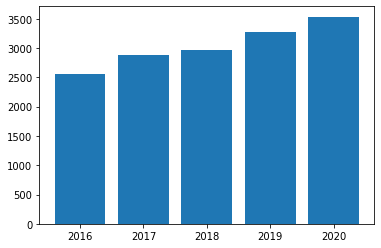

In [ ]:
plt.bar(df['해양사고발생(년도)'].unique(), plot)

## 파도부이

In [ ]:
DATA_PATH1 = 'sj1'
file_paths1 = [os.path.join(DATA_PATH1, filename) for filename in sorted(os.listdir(DATA_PATH1))]

DATA_PATH11 = 'sj2'
file_paths11 = [os.path.join(DATA_PATH11, filename) for filename in sorted(os.listdir(DATA_PATH11))]


In [ ]:
data_dfs1 = [pd.read_csv(file_path, encoding='cp949') for file_path in file_paths1]

data_dfs11 = [pd.read_csv(file_path, encoding='cp949') for file_path in file_paths11]


In [ ]:
sj1 = pd.concat(data_dfs1).reset_index(drop=True)
sj1.head()

,지점,일시,평균 수온(°C),최고 수온(°C),최저 수온(°C),평균 유의 파고(m),평균 파고(m),최고 유의 파고(m),최고 최대 파고(m),평균 파주기(sec),최고 파주기(sec)
0,22441,2016-01-01,11.5,11.9,11.0,0.8,0.5,1.2,1.6,5.3,5.8
1,22441,2016-01-02,11.7,11.9,11.5,1.3,0.8,1.7,2.7,6.5,7.3
2,22441,2016-01-03,11.7,12.1,11.5,0.8,0.5,1.2,1.7,5.6,6.1
3,22441,2016-01-04,12.1,12.6,11.6,0.6,0.4,0.8,1.2,5.5,6.2
4,22441,2016-01-05,11.5,12.2,11.0,0.7,0.4,0.8,1.1,6.0,6.7


In [ ]:
sj22 = pd.concat(data_dfs11).reset_index(drop=True)
sj222 = sj22.drop_duplicates(['지점'], keep = 'first')
sj2 = sj222.drop(['시작일', '종료일', '지점주소'], axis=1)
sj2.head()

,지점,지점명,관리관서,위도,경도
0,22441,독도,대구(구 143),37.2372,131.8694
2,22442,혈암,대구(구 143),37.5414,130.8542
3,22443,구암,대구(구 143),37.4789,130.8044
4,22444,신진도,NaN,36.6068,126.1261
5,22445,삽시도,대전지방기상청(133),36.3700,126.3350


In [ ]:
sj12= pd.merge(sj1, sj2, how='inner', on=None)
sj12.rename(columns={'위도':'lat', '경도':'long'},inplace=True)
sj12

,지점,일시,평균 수온(°C),최고 수온(°C),최저 수온(°C),평균 유의 파고(m),평균 파고(m),최고 유의 파고(m),최고 최대 파고(m),평균 파주기(sec),최고 파주기(sec),지점명,관리관서,lat,long
0,22441,2016-01-01,11.5,11.9,11.0,0.8,0.5,1.2,1.6,5.3,5.8,독도,대구(구 143),37.2372,131.8694
1,22441,2016-01-02,11.7,11.9,11.5,1.3,0.8,1.7,2.7,6.5,7.3,독도,대구(구 143),37.2372,131.8694
2,22441,2016-01-03,11.7,12.1,11.5,0.8,0.5,1.2,1.7,5.6,6.1,독도,대구(구 143),37.2372,131.8694
3,22441,2016-01-04,12.1,12.6,11.6,0.6,0.4,0.8,1.2,5.5,6.2,독도,대구(구 143),37.2372,131.8694
4,22441,2016-01-05,11.5,12.2,11.0,0.7,0.4,0.8,1.1,6.0,6.7,독도,대구(구 143),37.2372,131.8694
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
101130,22524,2020-12-27,15.2,15.6,14.8,0.5,0.3,0.6,0.7,6.0,7.2,구룡포,대구(구 143),35.9678,129.5986
101131,22524,2020-12-28,15.7,16.7,14.9,0.4,0.2,0.5,0.6,5.6,6.5,구룡포,대구(구 143),35.9678,129.5986
101132,22524,2020-12-29,15.2,16.1,15.0,0.5,0.3,1.0,1.2,5.8,7.6,구룡포,대구(구 143),35.9678,129.5986
101133,22524,2020-12-30,14.6,15.1,14.0,1.6,1.1,2.8,3.1,7.7,9.8,구룡포,대구(구 143),35.9678,129.5986


In [ ]:
sj12.dtypes

지점               int64
일시              object
평균 수온(°C)      float64
최고 수온(°C)      float64
최저 수온(°C)      float64
평균 유의 파고(m)    float64
평균 파고(m)       float64
최고 유의 파고(m)    float64
최고 최대 파고(m)    float64
평균 파주기(sec)    float64
최고 파주기(sec)    float64
지점명             object
관리관서            object
lat            float64
long           float64
dtype: object

In [ ]:
ji= sj12['지점명'].unique()

In [ ]:
m = folium.Map(location=[36.377247, 128.067197], zoom_start=7, prefer_canvas=True)

for i in range(len(sj12)):
  if i % 100 == 0:
    folium.Circle(location=sj12[['lat', 'long']].loc[i], radius=1, color='blue', fill_color='red', fill_opacity=0.7, line_opcity=0.7, tooltip=sj12['지점명'].iloc[i]).add_to(m)

for i in range(len(sj12)):
  if i % 300 == 0:
    folium.Circle(location=sj12[['lat', 'long']].loc[i], radius=sj12.groupby(sj12['지점']).max()['최고 유의 파고(m)'][sj12['지점'].iloc[i]]*3000, color='purple', fill_color='purple', fill_opacity=0.001, line_opcity=0.001, tooltip=sj12['지점명'].iloc[i]).add_to(m)  
  
m

## 해양기상부이

In [ ]:
DATA_PATH2 = 'sj3'
file_paths2 = [os.path.join(DATA_PATH2, filename) for filename in sorted(os.listdir(DATA_PATH2))]

DATA_PATH22 = 'sj4'
file_paths22 = [os.path.join(DATA_PATH22, filename) for filename in sorted(os.listdir(DATA_PATH22))]

In [ ]:
data_dfs2 = [pd.read_csv(file_path, encoding='cp949') for file_path in file_paths2]

data_dfs22 = [pd.read_csv(file_path, encoding='cp949') for file_path in file_paths22]


In [ ]:
sj3 = pd.concat(data_dfs2).reset_index(drop=True)
sj3.head()

,지점,일시,평균 풍속(m/s),평균기압(hPa),평균 상대습도(%),평균 기온(°C),평균 수온(°C),평균 최대 파고(m),평균 유의 파고(m),최고 유의 파고(m),최고 최대 파고(m),평균 파주기(sec),최고 파주기(sec)
0,21229,2016-01-01,4.5,NaN,49.0,8.9,13.1,1.4,0.9,1.3,1.9,5.3,6.4
1,21229,2016-01-02,5.7,NaN,56.0,10.9,13.0,2.3,1.5,2.3,3.3,5.7,7.1
2,21229,2016-01-03,3.6,1017.8,67.0,11.1,NaN,1.6,1.0,1.4,2.4,5.3,6.4
3,21229,2016-01-04,6.9,1017.8,62.0,9.5,13.0,2.1,1.4,1.9,2.9,5.8,7.1
4,21229,2016-01-05,6.6,1022.0,54.0,6.0,12.9,2.2,1.5,1.8,2.9,6.7,8.0


In [ ]:
sj444 = pd.concat(data_dfs22).reset_index(drop=True)
sj44 = sj444.drop_duplicates(['지점명'], keep = 'first')
sj4 = sj44.drop(['시작일', '종료일', '지점주소'], axis=1)
sj4.head()

,지점,지점명,관리관서,위도,경도
0,21229,울릉도,대구(구 143),37.4554,131.1144
1,22101,덕적도,인천기상대(112),37.2361,126.0188
2,22102,칠발도,목포기상대(165),34.7933,125.7769
3,22103,거문도,광주지방기상청(156),34.0014,127.5014
4,22104,거제도,부산지방기상청(159),34.7667,128.9000


In [ ]:
sj34= pd.merge(sj3, sj4, how='inner', on=None)
sj34.rename(columns={'위도':'lat', '경도':'long'},inplace=True)
sj34

,지점,일시,평균 풍속(m/s),평균기압(hPa),평균 상대습도(%),평균 기온(°C),평균 수온(°C),평균 최대 파고(m),평균 유의 파고(m),최고 유의 파고(m),최고 최대 파고(m),평균 파주기(sec),최고 파주기(sec),지점명,관리관서,lat,long
0,21229,2016-01-01,4.5,NaN,49.0,8.9,13.1,1.4,0.9,1.3,1.9,5.3,6.4,울릉도,대구(구 143),37.4554,131.1144
1,21229,2016-01-02,5.7,NaN,56.0,10.9,13.0,2.3,1.5,2.3,3.3,5.7,7.1,울릉도,대구(구 143),37.4554,131.1144
2,21229,2016-01-03,3.6,1017.8,67.0,11.1,NaN,1.6,1.0,1.4,2.4,5.3,6.4,울릉도,대구(구 143),37.4554,131.1144
3,21229,2016-01-04,6.9,1017.8,62.0,9.5,13.0,2.1,1.4,1.9,2.9,5.8,7.1,울릉도,대구(구 143),37.4554,131.1144
4,21229,2016-01-05,6.6,1022.0,54.0,6.0,12.9,2.2,1.5,1.8,2.9,6.7,8.0,울릉도,대구(구 143),37.4554,131.1144
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
31664,22194,2020-02-20,3.7,1032.8,67.0,8.0,9.0,0.6,0.3,0.5,0.7,3.6,5.8,홍도,광주지방기상청(156),34.7467,125.2456
31665,22194,2020-02-21,4.0,1028.9,77.0,9.6,8.8,0.6,0.4,0.5,0.7,3.0,4.6,홍도,광주지방기상청(156),34.7467,125.2456
31666,22194,2020-02-22,8.4,1028.3,65.0,8.1,8.8,2.4,1.5,2.2,3.6,5.1,7.1,홍도,광주지방기상청(156),34.7467,125.2456
31667,22194,2020-02-23,4.1,1029.8,59.0,6.6,8.9,2.1,1.3,1.9,3.2,5.7,7.1,홍도,광주지방기상청(156),34.7467,125.2456


In [ ]:
sj34.dtypes

지점               int64
일시              object
평균 풍속(m/s)     float64
평균기압(hPa)      float64
평균 상대습도(%)     float64
평균 기온(°C)      float64
평균 수온(°C)      float64
평균 최대 파고(m)    float64
평균 유의 파고(m)    float64
최고 유의 파고(m)    float64
최고 최대 파고(m)    float64
평균 파주기(sec)    float64
최고 파주기(sec)    float64
지점명             object
관리관서            object
lat            float64
long           float64
dtype: object

In [ ]:
m = folium.Map(location=[36.377247, 128.067197], zoom_start=7, prefer_canvas=True)

for i in range(len(sj34)):
  if i % 100 == 0:
    folium.Circle(location=sj34[['lat', 'long']].loc[i], radius=1, color='blue', fill_color='red', fill_opacity=0.7, line_opcity=0.7, tooltip=sj34['지점명'].iloc[i]).add_to(m)

for i in range(len(sj34)):
  if i % 100 == 0:
      folium.Circle(location=sj34[['lat', 'long']].loc[i], radius=sj34.groupby(sj34['지점']).max()['최고 유의 파고(m)'][sj34['지점'].iloc[i]]*5000, color='purple', fill_color='purple', fill_opacity=0.001, line_opcity=0.001, tooltip=sj34['지점명'].iloc[i]).add_to(m)  

m